In [11]:
import pandas as pd
import geopandas as gpd
from geocube.api.core import make_geocube
from geocube.rasterize import rasterize_image
from functools import partial
from rasterio.enums import MergeAlg
from shapely.geometry import Polygon
import rasterio
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image,ImageDraw,ImageFilter
import os
import tifffile
import cv2
import json

In [6]:
# def polygonsProj():
#     # Read Polygon Shapefile
#     cal_census = gpd.read_file('./labeled_zipped/BVM_labeled.zip')
#     cal_census = cal_census.rename(columns={'Label': 'label'})
#     # Reprojecting to 32631 coordinate system
#     cal_census.set_crs(epsg="31370",inplace=True)
#     print(cal_census.crs)
#     cal_census.to_crs(epsg = "32631", inplace = True)
#     print(cal_census.crs)
#     #cal_census = cal_census.to_crs('EPSG:32631')
#     return cal_census

In [169]:
def polygonsToRaster(to_raster_list,patch_number):
#     cal_census = gpd.read_file('./labeled_zipped/BVM_labeled.zip')
#     cal_census = cal_census.rename(columns={'Label': 'label'})
    # Reprojecting to 32631 coordinate system
#     cal_census.set_crs(epsg="31370",inplace=True)
#     print(cal_census.crs)
#     cal_census.to_crs(epsg = "32631", inplace = True)
#     print(cal_census.crs)
#     cal_census.to_crs(epsg = '4326', inplace = True)
#     print(cal_census.crs)
    # Using GeoCube to rasterize the Vector
    for i in range(patch_number):
        if len(to_raster_list[i]) == 0:
            print(f'{i}:NA')
            continue
        to_raster = to_raster_list[i]
        to_raster.to_crs(epsg = "32631", inplace = True)
        print(f'{i}:{len(to_raster)}')
        to_raster_raster = make_geocube(
            vector_data=to_raster,
            measurements=["label"],
            resolution=(-10, 10),
            fill = 0
        )

        # Save raster census raster

        patch_tiff_dir = f'./loc_raster_{i}.tiff'
        to_raster_raster.rio.to_raster(patch_tiff_dir)
#     to_raster_raster.rio.to_raster('./loc_raster.tiff')

In [131]:
cal_census = gpd.read_file('./labeled_zipped/BVM_labeled.zip')
cal_census = cal_census.rename(columns={'Label': 'label'})
cal_census.set_crs(epsg="31370",inplace=True)
print(cal_census.crs)
cal_census.to_crs(epsg = '4326', inplace = True)
print(cal_census.crs)

EPSG:31370
EPSG:4326


In [14]:
with open('./locations20/random_loc_coords.json') as loc_json:
    loc_boundaries = json.load(loc_json)
    print(loc_boundaries)

[{'west': 4.560297293714416, 'east': 4.660297293714415, 'north': 50.72823786448315, 'south': 50.67823786448315, 'crs': 'EPSG:4326'}, {'west': 5.6789947430592935, 'east': 5.778994743059293, 'north': 50.80365090797564, 'south': 50.75365090797564, 'crs': 'EPSG:4326'}, {'west': 4.393935654424625, 'east': 4.493935654424624, 'north': 50.86338239521432, 'south': 50.813382395214326, 'crs': 'EPSG:4326'}, {'west': 5.5506451376260895, 'east': 5.650645137626089, 'north': 50.98925978099421, 'south': 50.93925978099421, 'crs': 'EPSG:4326'}, {'west': 4.7715846856506205, 'east': 4.87158468565062, 'north': 51.48710946803507, 'south': 51.437109468035075, 'crs': 'EPSG:4326'}, {'west': 2.869570073699053, 'east': 2.9695700736990527, 'north': 51.14851427291403, 'south': 51.09851427291403, 'crs': 'EPSG:4326'}, {'west': 4.383516100363594, 'east': 4.483516100363594, 'north': 50.81155727036711, 'south': 50.76155727036711, 'crs': 'EPSG:4326'}, {'west': 4.046007068543278, 'east': 4.146007068543278, 'north': 51.123

In [134]:
loc_rectangles = []
loc_gdfs = []
print(f'current_patchBoundaryCRS:{cal_census.crs}')
for loc in loc_boundaries:
    frame = {}
    frame['west'] = loc['west']
    frame['east'] = loc['east']
    frame['north'] = loc['north']
    frame['south'] = loc['south']
# frame = {}
# frame['west'] = loc_center[1] - 0.05
# frame['east'] = loc_center[1] + 0.05
# frame['north'] = loc_center[0] + 0.025
# frame['south'] = loc_center[0] - 0.025
    loc_rectangle = Polygon([(frame['west'],frame['south']), (frame['west'],frame['north']), (frame['east'],frame['north']), (frame['east'], frame['south']), (frame['west'],frame['south'])])
    loc_rectangles.append(loc_rectangle)
    loc_gdf = gpd.GeoDataFrame([1], geometry=[loc_rectangle], crs=cal_census.crs)
    loc_gdfs.append(loc_gdf)

current_patchBoundaryCRS:EPSG:4326


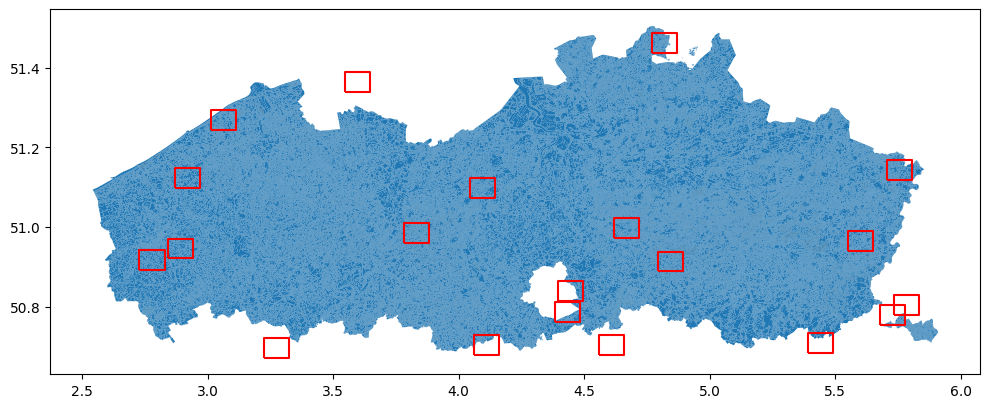

In [82]:
# fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 8))
fig, ax1 = plt.subplots(1, 1, figsize=(12, 8))
cal_census.plot(ax=ax1)
for patch in loc_gdfs:
    patch.boundary.plot(ax=ax1,color='red')
# loc_gdf.boundary.plot(ax=ax1,color="red")
plt.show()

In [180]:
loc_patches = []
print(cal_census.crs)
print(type(cal_census))
print(type(loc_rectangles[0]))
for loc_rect in loc_rectangles:
    loc_clipped = gpd.clip(cal_census,loc_rect,keep_geom_type=False)
    loc_patches.append(loc_clipped)

EPSG:4326
<class 'geopandas.geodataframe.GeoDataFrame'>
<class 'shapely.geometry.polygon.Polygon'>


In [178]:
polygonsToRaster(loc_patches,len(loc_patches))

0:NA
1:1032
2:300
3:1840
4:1356
5:1345
6:427
7:1852
8:2692
9:NA
10:3380
11:NA
12:3738
13:1602
14:12
15:897
16:1721
17:88
18:418
19:1124


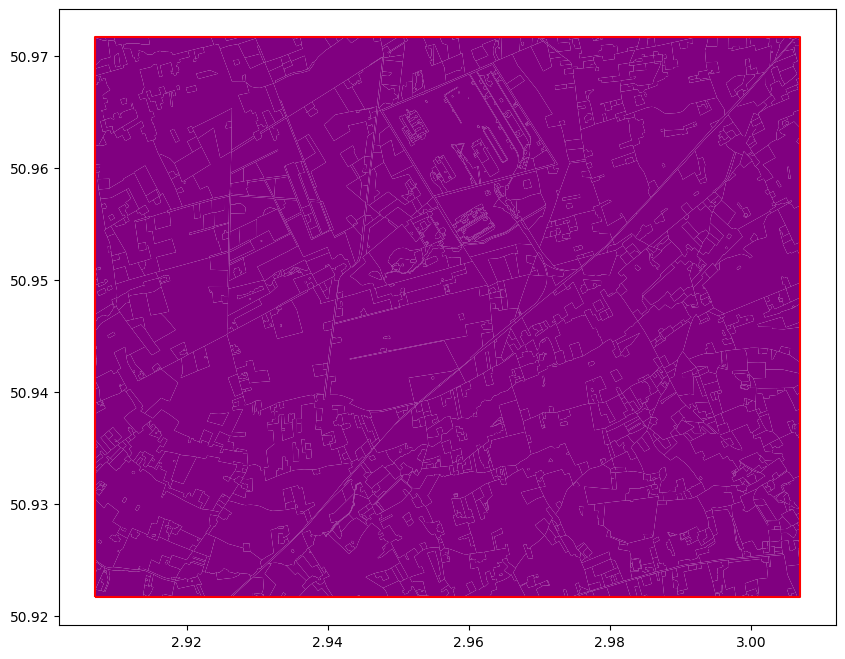

In [51]:
# loc_clipped = gpd.clip(cal_census,loc_rectangle)
# fig, ax = plt.subplots(figsize=(12, 8))
# loc_clipped.plot(ax=ax, color="purple")
# loc_gdf.boundary.plot(ax=ax, color="red")
# plt.show()

In [52]:
# polygonsToRaster(loc_clipped)

In [124]:
DEFAULT_FIGSIZE = (10, 8)

def show_tiff(filename:str, figsize=DEFAULT_FIGSIZE, vmin=None, vmax=None, rescale_percentile=100, add_colorbar=False):
    """Small helper to load a geotiff and visualize it"""
    with rasterio.open(filename) as ds:
        data = ds.read()
    ret_data = data
    fig, ax = plt.subplots(figsize=figsize)

    if len(data.shape) == 3:
        if data.max() > 500:
            p = np.percentile(data, rescale_percentile, axis=[1,2])
            data = data / p[:, None, None]
            data = np.clip(data, 0, 1)
        data = np.moveaxis(data, 0, 2)
        
    im = ax.imshow(data, vmin=vmin, vmax=vmax)
    if add_colorbar:
        fig.colorbar(im, ax=ax, fraction=0.05)
    return ret_data

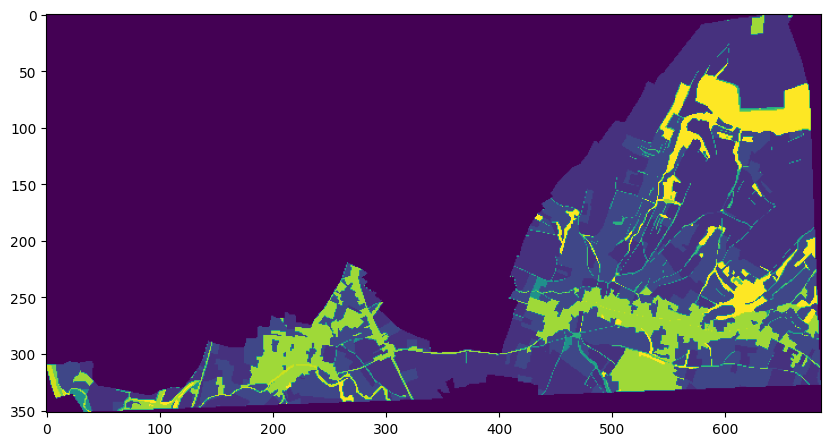

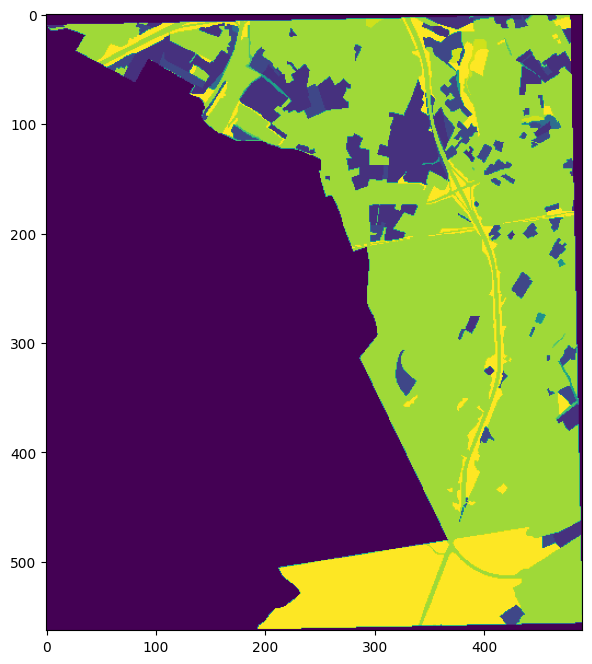

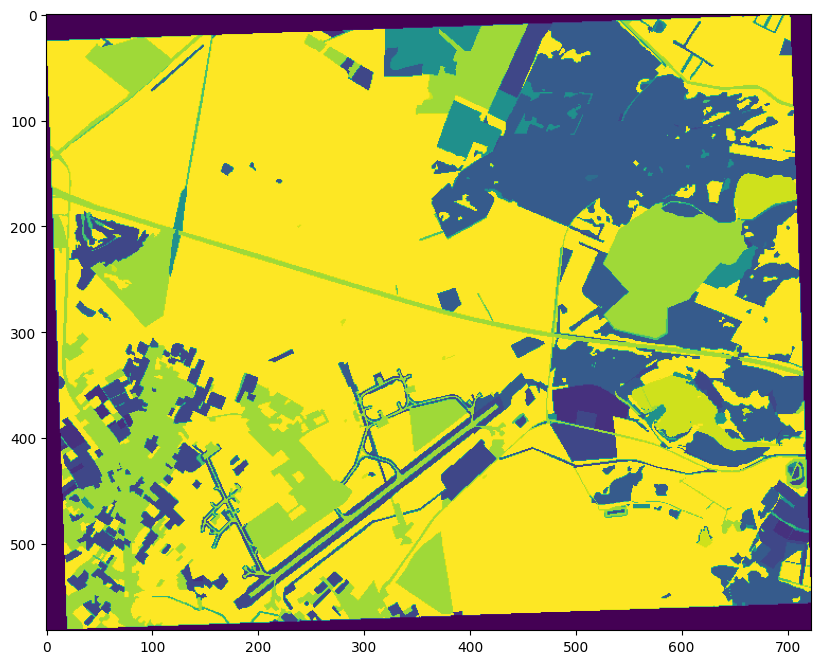

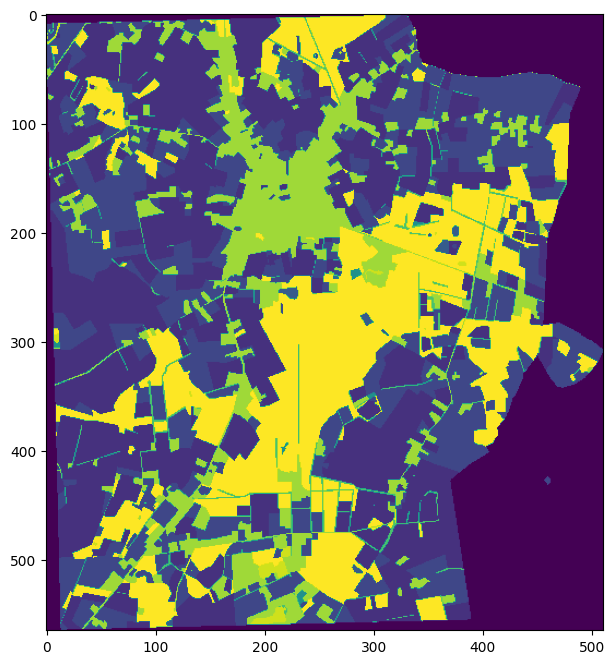

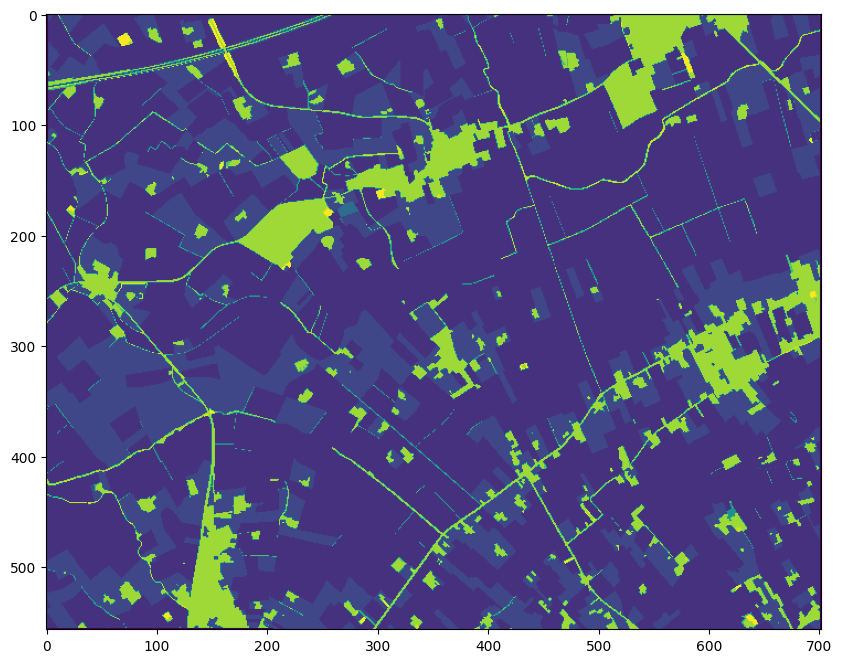

...

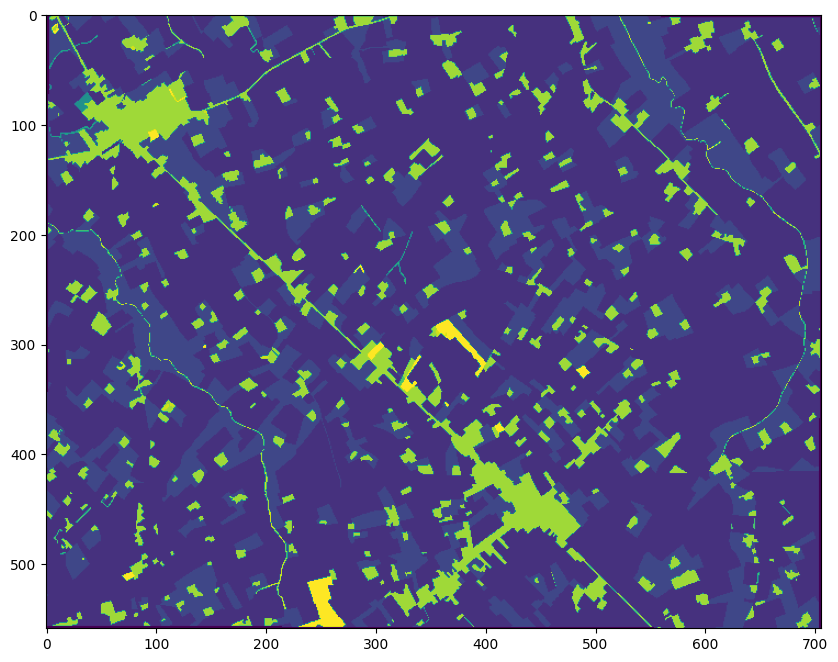

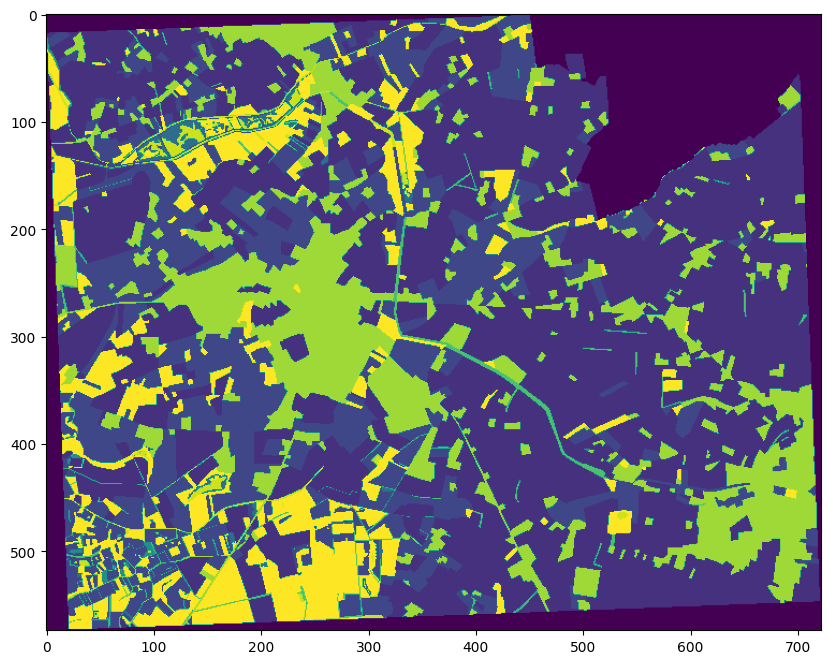

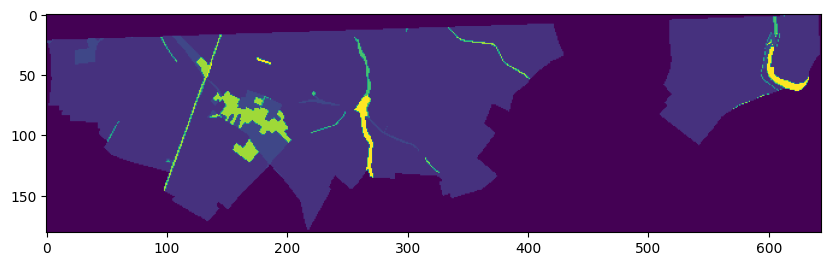

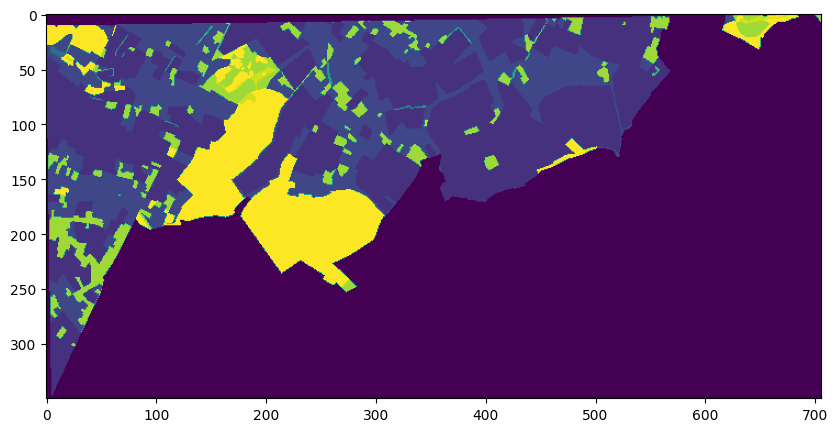

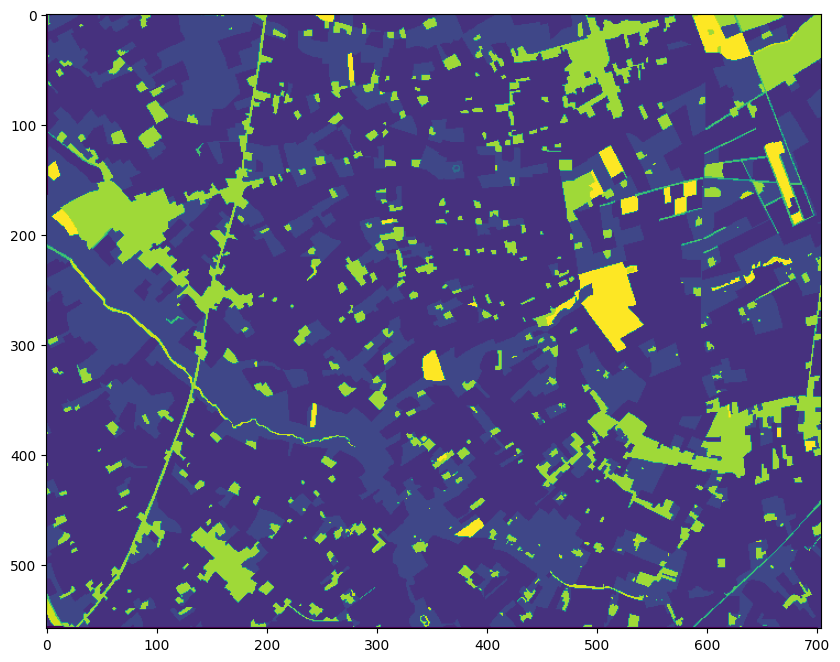

In [204]:
for k in range(len(loc_patches)):
    if len(loc_patches[k]) == 0:
        continue
    else:
        ret_data=show_tiff(f'./loc_raster_{k}.tiff')

In [61]:
img = tifffile.imread('./loc_raster_16.tiff')

In [62]:
# unqvals = np.unique(img)
# print(unqvals.dtype)
# print(unqvals)
# print(type(img))
# print(img.shape)
# print(img)
# all_labels = np.arange(0,15,1,'float64')
# heatmap_labels = np.arange(0,256,256/len(all_labels),'float64')
# print(all_labels)
# print(heatmap_labels)
# for i in range(len(all_labels)):
#   img[img==all_labels[i]]=heatmap_labels[i]
# print(img)
# data = Image.fromarray(img)
# if data.mode != 'RGB':
#     data = data.convert('RGB')
# data.save('loc_raster.png')
# trans_data = Image.open('./loc_raster.png')
# trans_data.putalpha(127)  
# trans_data.save('./loc_raster_transparent.png')

float64
[ 0.  2.  3.  4.  5.  7.  8.  9. 10. 12. 13. 14.]
<class 'numpy.ndarray'>
(574, 722)
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12. 13. 14.]
[  0.          17.06666667  34.13333333  51.2         68.26666667
  85.33333333 102.4        119.46666667 136.53333333 153.6
 170.66666667 187.73333333 204.8        221.86666667 238.93333333]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [63]:
# image = cv2.imread('loc_raster_transparent.png', 0)
# colormap = plt.get_cmap('inferno')
# heatmap = (colormap(image) * 2**16).astype(np.uint16)[:,:,:3]
# heatmap = cv2.cvtColor(heatmap, cv2.COLOR_RGB2BGR)

# cv2.imshow('image', image)
# cv2.imshow('heatmap', heatmap)
# cv2.waitKey()

-1

In [64]:
# sat_img = tifffile.imread('./locations20/location_17.tiff')
# sat_img = sat_img.transpose(1,2,0)
# print(sat_img[55,55,2])
# print(sat_img.dtype)
# print(sat_img.shape)
# sat_img = np.uint8(sat_img)
# print(sat_img[55,55,0])
# sat1 = Image.fromarray(sat_img)
# print(sat1.mode)
# # if sat1.mode != 'RGB':
# #     sat1 = sat1.convert('RGB')
# sat1.save('sat_img.png')

247
int16
(580, 725, 3)
148
RGB


In [65]:
# background = Image.open("sat_img.png")
# foreground = Image.open("loc_raster_transparent.png")

# background.paste(foreground, (0, 0), foreground)
# background.show()

(583, 726, 3)
(352, 685)
(571, 716, 3)
(563, 490)
(582, 723, 3)
(582, 723)
(574, 709, 3)
(565, 511)
(557, 702, 3)
(557, 702)
(570, 716, 3)
(570, 706)
(567, 709, 3)
(567, 709)
(565, 709, 3)
(565, 709)
(573, 715, 3)
(573, 715)
(575, 718, 3)
(575, 718)
(558, 699, 3)
(558, 699)
(583, 727, 3)
(40, 110)
(559, 706, 3)
(559, 706)
(583, 722, 3)
(574, 722)
(580, 725, 3)
(181, 644)
(568, 715, 3)
(350, 706)
(558, 704, 3)
(558, 704)


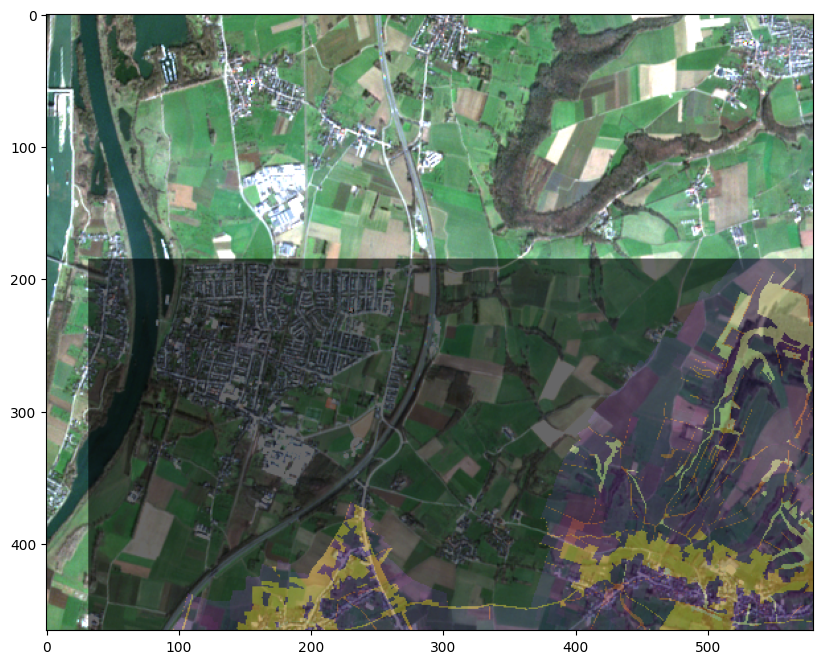

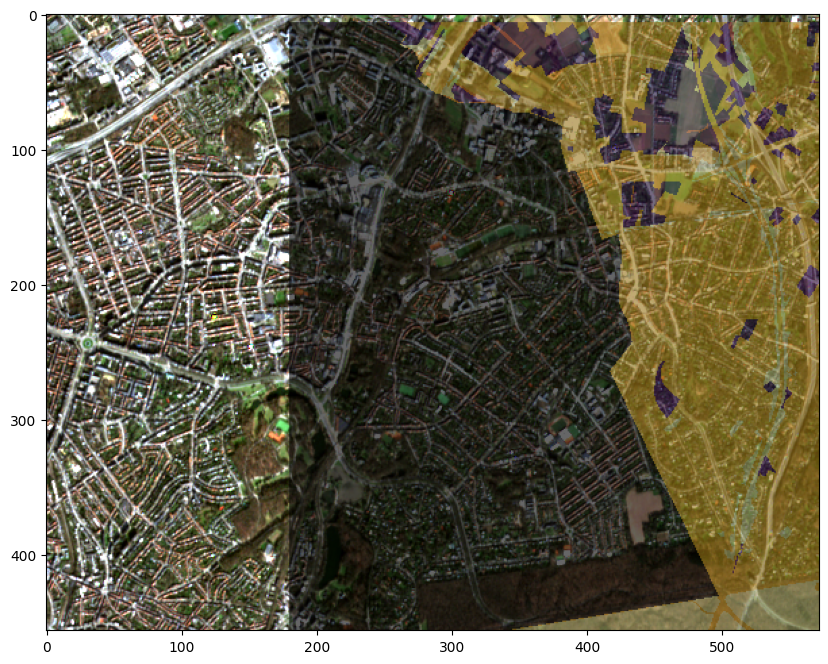

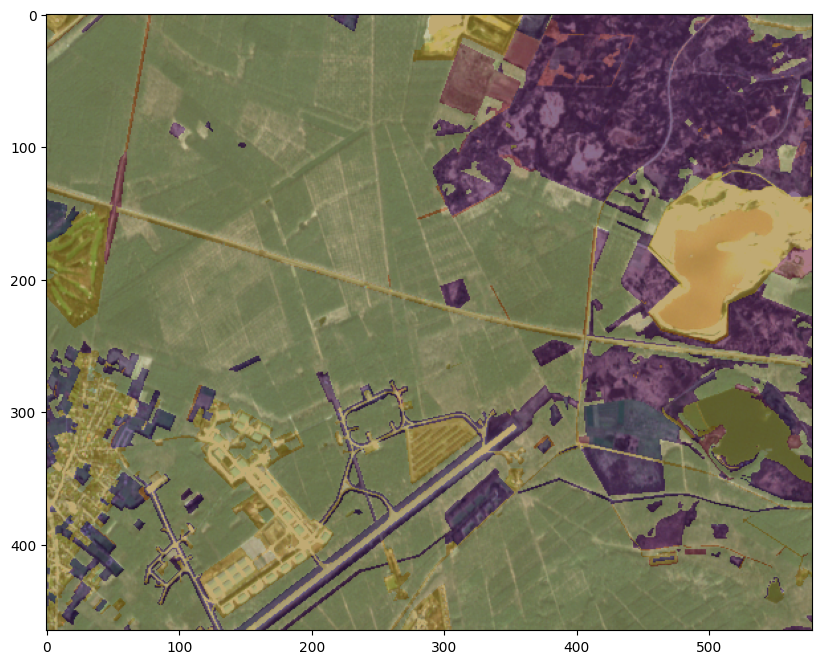

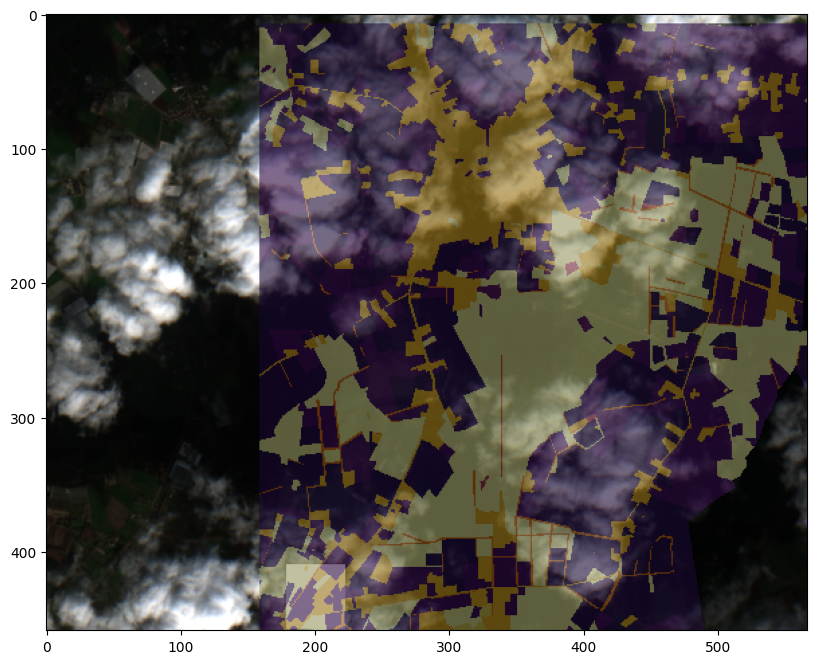

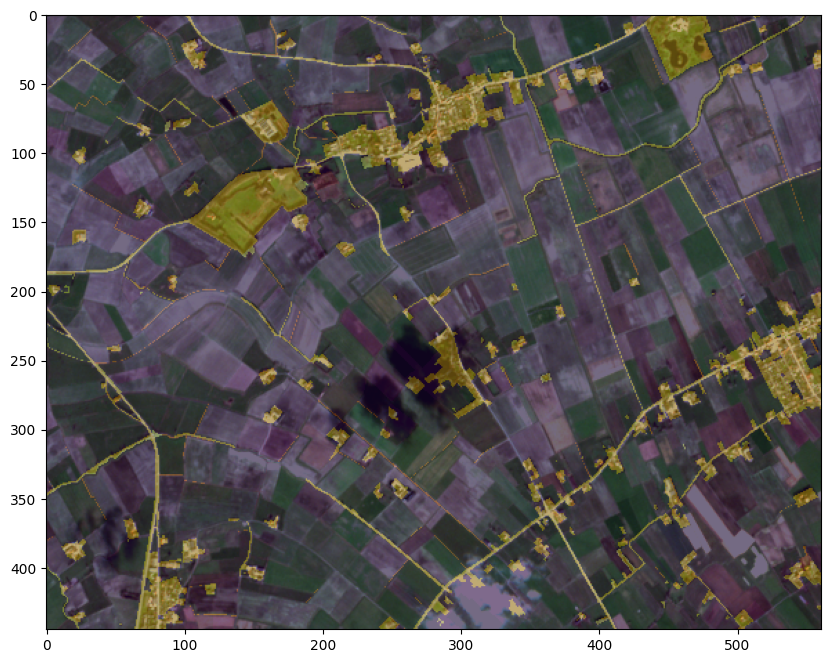

...

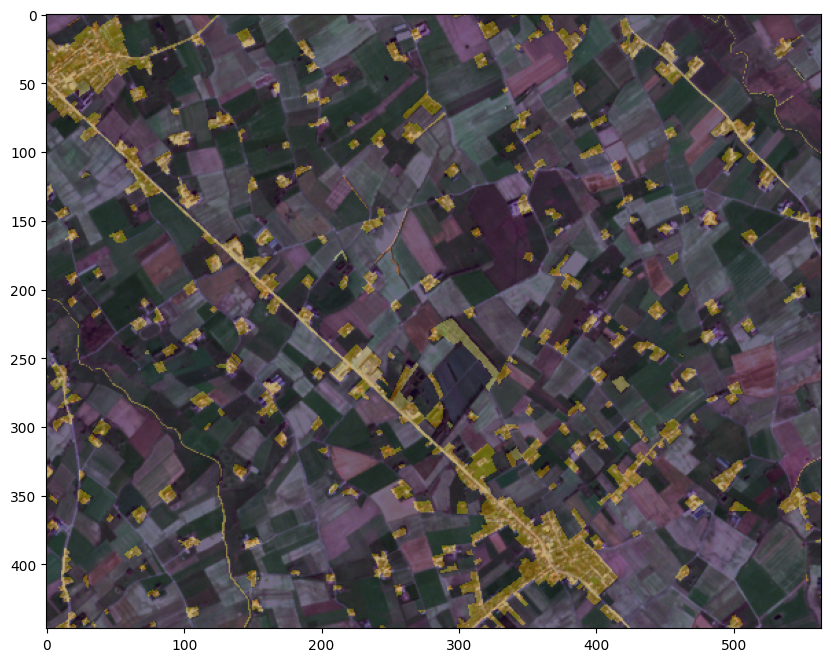

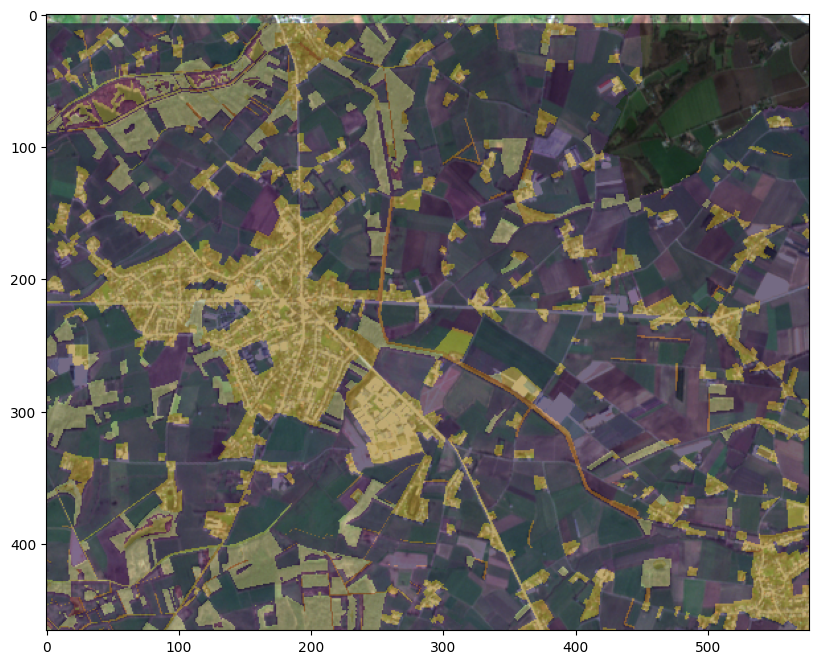

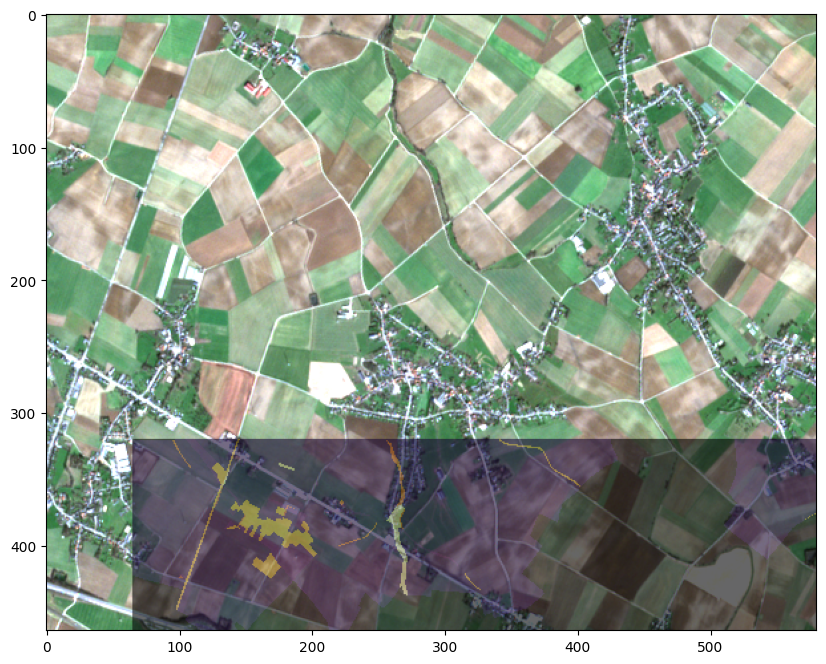

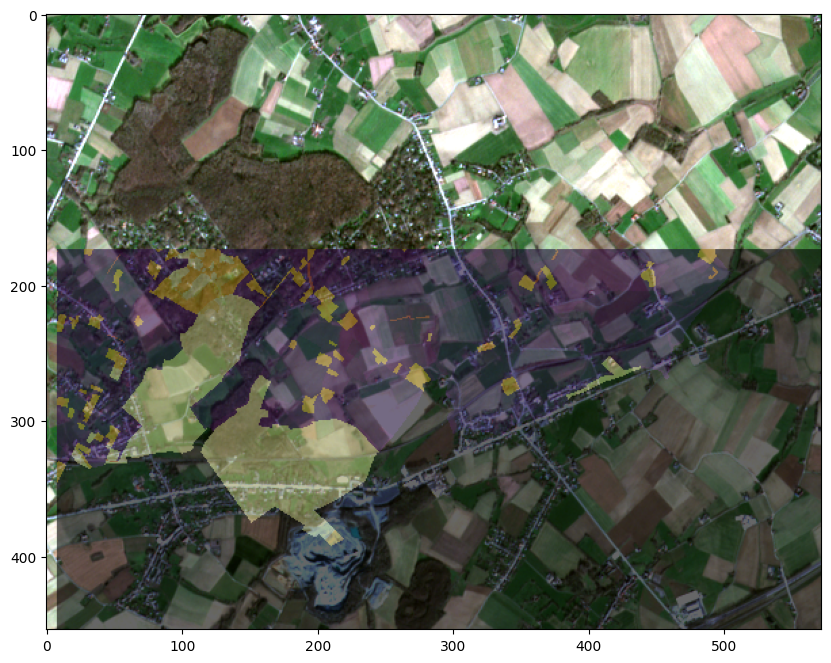

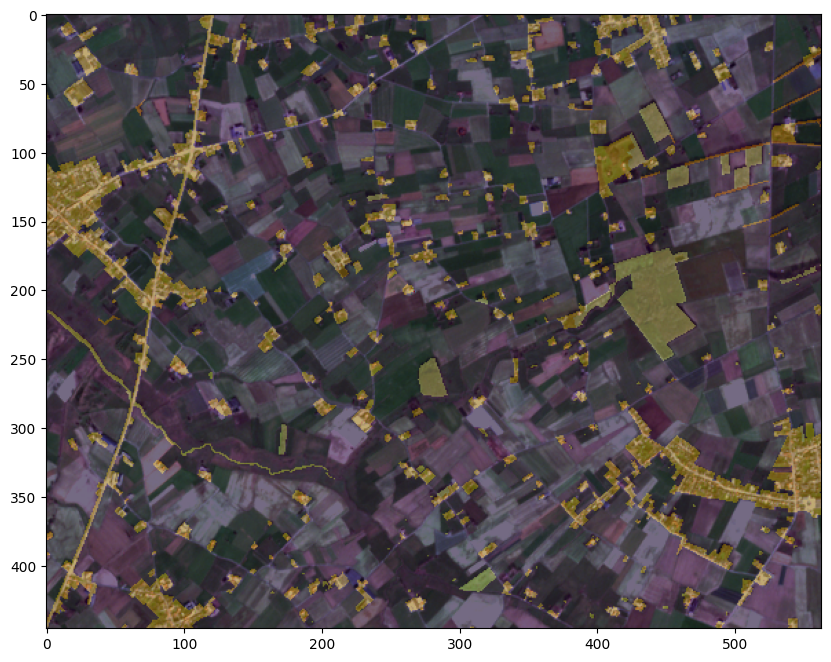

In [209]:
import matplotlib
from PIL import Image, ImageOps

def pil_cm(im, cm='inferno'):
     cm_hot = matplotlib.colormaps.get_cmap(cm)
     im = np.array(im)
     im = cm_hot(im)
     im = np.uint8(im * 255)
     im = Image.fromarray(im)
     return im


def trans_paste(fg_img,bg_img,alpha=1.0,box=(0,0)):
     fg_img_trans = Image.new("RGBA",fg_img.size)
     fg_img_trans = Image.blend(fg_img_trans,fg_img,alpha)
     bg_img.paste(fg_img_trans,box,fg_img_trans)
     return bg_img

def add_margin(pil_img, top, right, bottom, left):
    width, height = pil_img.size
    new_width = width + right + left
    new_height = height + top + bottom
    result = Image.new(pil_img.mode, (new_width, new_height))
    result.paste(pil_img, (left, top))
    return result

for l in range(len(loc_patches)):
    if len(loc_patches[l]) == 0:
        continue
    else:
        data_sat = tifffile.imread(f'./locations20/location_{l}.tiff')
        if len(data_sat.shape) == 3:
             if data_sat.max() > 500:
                 p = np.percentile(data_sat, 97, axis=[1,2])
                 data_sat = data_sat / p[:, None, None]
                 data_sat = np.clip(data_sat, 0, 1)
             data_sat = np.moveaxis(data_sat, 0, 2)
        data_sat = np.uint8(data_sat * 255 / data_sat.max())
        print(data_sat.shape)
        #take center portion of image
        o,k,_ = data_sat.shape
        startk = k//2-k*0.8//2
        starto = o//2-o*0.8//2
        data_sat=data_sat[int(starto):int(starto+o*0.8//1),int(startk):int(startk+k*0.8//1)]
        img_sat = Image.fromarray(data_sat, mode='RGB')
        
        
        
        data_gt = tifffile.imread(f'./loc_raster_{l}.tiff')
        print(data_gt.shape)
        data_gt = np.uint8(data_gt * 255 / data_gt.max())
        
        #take center portion of image
        y,x = data_gt.shape
        startx = x//2-x*0.8//2
        starty = y//2-y*0.8//2
        data_gt=data_gt[int(starty):int(starty+y*0.8//1),int(startx):int(startx+x*0.8//1)]
        img_gt = Image.fromarray(data_gt, mode='L')
        img_gt = pil_cm(img_gt)

        img_gt_pad = add_margin(img_gt,data_sat.shape[0]-data_gt.shape[0],0,0,data_sat.shape[1]-data_gt.shape[1])
        
        merged = trans_paste(img_gt_pad,img_sat,alpha=0.6)
        merged.save(f'merged_{l}.tiff')
        show_tiff(f'./merged_{l}.tiff')